# Assignment 3

In the third lab assignment, you are tasked with creating a machine learning pipeline using the [Adult dataset](https://archive.ics.uci.edu/dataset/2/adult).  
The objective of this dataset is to classify whether a particular individual has an income of more than $50,000 per year based on some features.

During the assignment, you are asked to create a complete machine learning pipeline for this dataset. Specifically, the assignment consists of two parts. In the first part of the assignment, you are asked to perform some exploratory data analysis along with some data preprocessing steps to transform your data into the right format. The second part of the assignment involves selecting the best model for your problem using a model selection method introduced in the second lab of the course.

You can download the dataset from the website.   
The folder, it contains:  
1. The data that you are going to use to develop your model (or development set): `adult.data`
2. The test set: `adult.test`
3. A description file for the dataset: `adult.names`

You have to complete the current notebook and submit it through the course website.

## Assignment Steps:

### A. Data Analysis and Preprocessing

1. **Load the development data and provide some basic information about the dataset using the `adult.data` file:**
   - Provide a short description of the dataset (a few sentences about the dataset and the features).
   - How many examples (rows) are in the dataset?
   - How many features do you have in your dataset?
   - What are the types of the different features?
   - Do you have any missing data in your dataset? Hint: check for different missing value identifiers.

2. **Transform your data into the right format to be handled by your model:**
    - Handle missing values, and explain your decision.
    - Handle categorical features, and explain your decision.
    - Do you need to scale your data to transform the different features into the same scale?
    
3. **Load the test set and perform the same steps as before. Is the test set consistent with the training set?**

### B. Model Selection

In the model selection phase, you need to choose the best model between k-nearest neighbors (KNN) and logistic regression classifiers for different model hyperparameters.

1. Explain the different algorithms (provide a few sentences about each model).
2. Define the different hyperparameters and their respective values that you want to explore for each algorithm. For the logistic regression, try only the fit_intercept hyperparameter while keeping fixed the penalty equal to None, as the rest will be explained later in the course.

   - Example: `logistic_regression = LogisticRegression(penalty=None, fit_intercept=setting)`

3. Choose a model selection method and explain your decision.
4. Perform model selection and find the best model. Choose between "train/val" and cross validation method.
5. Test your best algorithm on both test-set and training-set and explain the results.
6. Compare your results with the benchmarks on the [website](https://archive.ics.uci.edu/dataset/2/adult).

Remember to create different cells and use Markdown to write text in the notebook.

##### Useful Material:
1. [Model Selection and KNN - Lab 2](https://github.com/olethrosdc/machine-learning-MSc/blob/main/src/Generalisation/Lab_2_Generalization.ipynb) 
2. [Data Preprocessing and Logistic Regression - Lab 3](https://github.com/olethrosdc/machine-learning-MSc/blob/main/src/LogisticRegression/Lab_3_Preprocessing_Logistic_Regression.ipynb)
3. Course Book (Chapters 1, 2, 4, 5)
4. [Markdown Guide](https://www.edlitera.com/en/blog/posts/jupyter-markdown-tutorial)


In [192]:
import pandas as pd
import numpy as np
import os
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from typing import List, Callable, Tuple, Dict, Type
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [193]:
DATA_PATH = os.path.join("adult")
ADULT_DATA_DEVELOP_PATH = os.path.join(DATA_PATH, "adult.data")
ADULT_DATA_TEST_PATH = os.path.join(DATA_PATH, "adult.data")

# Part 1 - Load the development data and provide some basic information about the dataset using the `adult.data` file

- `age`: continuous.
- `workclass`: Private, Self-emp-not-inc, Self-emp-inc, Federal-gov, Local-gov, State-gov, Without-pay, Never-worked.
- `fnlwgt` -> `final_weight`: continuous.
- `education`: Bachelors, Some-college, 11th, HS-grad, Prof-school, Assoc-acdm, Assoc-voc, 9th, 7th-8th, 12th, Masters, 1st-4th, 10th, Doctorate, 5th-6th, Preschool.
- `education-num`: continuous.
- `marital-status`: Married-civ-spouse, Divorced, Never-married, Separated, Widowed, Married-spouse-absent, Married-AF-spouse.
- `occupation`: Tech-support, Craft-repair, Other-service, Sales, Exec-managerial, Prof-specialty, Handlers-cleaners, Machine-op-inspct, Adm-clerical, Farming-fishing, Transport-moving, Priv-house-serv, Protective-serv, Armed-Forces.
- `relationship`: Wife, Own-child, Husband, Not-in-family, Other-relative, Unmarried.
- `race`: White, Asian-Pac-Islander, Amer-Indian-Eskimo, Other, Black.
- `sex`: Female, Male.
- `capital-gain`: continuous.
- `capital-loss`: continuous.
- `hours-per-week`: continuous.
- `native-country`: United-States, Cambodia, England, Puerto-Rico, Canada, Germany, Outlying-US(Guam-USVI-etc), India, Japan, Greece, South, China, Cuba, Iran, Honduras, Philippines, Italy, Poland, Jamaica, Vietnam, Mexico, Portugal, Ireland, France, Dominican-Republic, Laos, Ecuador, Taiwan, Haiti, Columbia, Hungary, Guatemala, Nicaragua, Scotland, Thailand, Yugoslavia, El-Salvador, Trinadad&Tobago, Peru, Hong, Holand-Netherlands.


In [194]:
column_names = [
    "age",
    "workclass",
    "final_weight",
    "education",
    "education-num",
    "marital-status",
    "occupation",
    "relationship",
    "race",
    "sex",
    "capital-gain",
    "capital-loss",
    "hours-per-week",
    "native-country",
    "income_class"
]
feature_columns = column_names[:-1]
label_columns = column_names[-1]

In [195]:
adult_data_develop_df = pd.read_csv(ADULT_DATA_DEVELOP_PATH, sep=",", header=None, names=column_names, index_col=None, skipinitialspace=True)
adult_data_test_df = pd.read_csv(ADULT_DATA_DEVELOP_PATH, sep=",", header=None, names=column_names, index_col=None, skipinitialspace=True)

In [196]:
adult_data_develop_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32557,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32558,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
32559,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


In [197]:
adult_data_test_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32557,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32558,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
32559,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


## 1.1 Provide a short description of the dataset (a few sentences about the dataset and the features).

## 1.2 How many examples (rows) are in the dataset?

In [198]:
print(f"Develop set - Rows: {adult_data_develop_df.shape[0]}")
print(f"Develop set - Columns: {adult_data_develop_df.shape[1]}")

print(f"Test set - Rows: {adult_data_test_df.shape[0]}")
print(f"Test set - Columns: {adult_data_test_df.shape[1]}")

Develop set - Rows: 32561
Develop set - Columns: 15
Test set - Rows: 32561
Test set - Columns: 15


## 1.3 How many features do you have in your dataset?

In [199]:
print(f"Number of the features: {len(feature_columns)}")

Number of the features: 14


## 1.4 What are the types of the different features?

In [200]:
adult_data_develop_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       32561 non-null  object
 2   final_weight    32561 non-null  int64 
 3   education       32561 non-null  object
 4   education-num   32561 non-null  int64 
 5   marital-status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital-gain    32561 non-null  int64 
 11  capital-loss    32561 non-null  int64 
 12  hours-per-week  32561 non-null  int64 
 13  native-country  32561 non-null  object
 14  income_class    32561 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [201]:
adult_data_test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       32561 non-null  object
 2   final_weight    32561 non-null  int64 
 3   education       32561 non-null  object
 4   education-num   32561 non-null  int64 
 5   marital-status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital-gain    32561 non-null  int64 
 11  capital-loss    32561 non-null  int64 
 12  hours-per-week  32561 non-null  int64 
 13  native-country  32561 non-null  object
 14  income_class    32561 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [202]:
adult_data_develop_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32557,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32558,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
32559,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


In [203]:
adult_data_test_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32557,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32558,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
32559,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


The types corresponds to the data we see in the DataFrame, no need to convert any columns to other types

## 1.5 Do you have any missing data in your dataset? Hint: check for different missing value identifiers.

In [204]:
adult_data_develop_df.isnull().values.any(), adult_data_test_df.isnull().values.any()

(False, False)

No missing data in the dataset

## Part 2 - Transform your data into the right format to be handled by your model


- `age`: continuous.
- **`workclass`: Private, Self-emp-not-inc, Self-emp-inc, Federal-gov, Local-gov, State-gov, Without-pay, Never-worked.**
- `fnlwgt` -> `final_weight`: continuous.
- **`education`: Bachelors, Some-college, 11th, HS-grad, Prof-school, Assoc-acdm, Assoc-voc, 9th, 7th-8th, 12th, Masters, 1st-4th, 10th, Doctorate, 5th-6th, Preschool.**
- `education-num`: continuous.
- **`marital-status`: Married-civ-spouse, Divorced, Never-married, Separated, Widowed, Married-spouse-absent, Married-AF-spouse.**
- **`occupation`: Tech-support, Craft-repair, Other-service, Sales, Exec-managerial, Prof-specialty, Handlers-cleaners, Machine-op-inspct, Adm-clerical, Farming-fishing, Transport-moving, Priv-house-serv, Protective-serv, Armed-Forces.**
- **`relationship`: Wife, Own-child, Husband, Not-in-family, Other-relative, Unmarried.**
- **`race`: White, Asian-Pac-Islander, Amer-Indian-Eskimo, Other, Black.**
- **`sex`: Female, Male.**
- `capital-gain`: continuous.
- `capital-loss`: continuous.
- `hours-per-week`: continuous.
- **`native-country`: United-States, Cambodia, England, Puerto-Rico, Canada, Germany, Outlying-US(Guam-USVI-etc), India, Japan, Greece, South, China, Cuba, Iran, Honduras, Philippines, Italy, Poland, Jamaica, Vietnam, Mexico, Portugal, Ireland, France, Dominican-Republic, Laos, Ecuador, Taiwan, Haiti, Columbia, Hungary, Guatemala, Nicaragua, Scotland, Thailand, Yugoslavia, El-Salvador, Trinadad&Tobago, Peru, Hong, Holand-Netherlands.**

The bold properties are categorical features

In [205]:
categorical_features = [
    "workclass",
    "education",
    "marital-status",
    "occupation",
    "relationship",
    "race",
    "sex",
    "native-country",
    "income_class"
]

In [206]:
def label_encode_df(df: pd.DataFrame, columns: List[str]) -> pd.DataFrame:
    label_encoder = LabelEncoder()
    df = df.copy()
    df[columns] = df[columns].apply(lambda column: label_encoder.fit_transform(column))
    return df

In [207]:
adult_data_develop_numerical_df = label_encode_df(adult_data_develop_df, categorical_features)
adult_data_develop_numerical_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,39,7,77516,9,13,4,1,1,4,1,2174,0,40,39,0
1,50,6,83311,9,13,2,4,0,4,1,0,0,13,39,0
2,38,4,215646,11,9,0,6,1,4,1,0,0,40,39,0
3,53,4,234721,1,7,2,6,0,2,1,0,0,40,39,0
4,28,4,338409,9,13,2,10,5,2,0,0,0,40,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,4,257302,7,12,2,13,5,4,0,0,0,38,39,0
32557,40,4,154374,11,9,2,7,0,4,1,0,0,40,39,1
32558,58,4,151910,11,9,6,1,4,4,0,0,0,40,39,0
32559,22,4,201490,11,9,4,1,3,4,1,0,0,20,39,0


In [208]:
adult_data_test_numerical_df = label_encode_df(adult_data_test_df, categorical_features)
adult_data_test_numerical_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,39,7,77516,9,13,4,1,1,4,1,2174,0,40,39,0
1,50,6,83311,9,13,2,4,0,4,1,0,0,13,39,0
2,38,4,215646,11,9,0,6,1,4,1,0,0,40,39,0
3,53,4,234721,1,7,2,6,0,2,1,0,0,40,39,0
4,28,4,338409,9,13,2,10,5,2,0,0,0,40,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,4,257302,7,12,2,13,5,4,0,0,0,38,39,0
32557,40,4,154374,11,9,2,7,0,4,1,0,0,40,39,1
32558,58,4,151910,11,9,6,1,4,4,0,0,0,40,39,0
32559,22,4,201490,11,9,4,1,3,4,1,0,0,20,39,0


In [209]:
adult_data_develop_numerical_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   age             32561 non-null  int64
 1   workclass       32561 non-null  int64
 2   final_weight    32561 non-null  int64
 3   education       32561 non-null  int64
 4   education-num   32561 non-null  int64
 5   marital-status  32561 non-null  int64
 6   occupation      32561 non-null  int64
 7   relationship    32561 non-null  int64
 8   race            32561 non-null  int64
 9   sex             32561 non-null  int64
 10  capital-gain    32561 non-null  int64
 11  capital-loss    32561 non-null  int64
 12  hours-per-week  32561 non-null  int64
 13  native-country  32561 non-null  int64
 14  income_class    32561 non-null  int64
dtypes: int64(15)
memory usage: 3.7 MB


In [210]:
adult_data_test_numerical_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   age             32561 non-null  int64
 1   workclass       32561 non-null  int64
 2   final_weight    32561 non-null  int64
 3   education       32561 non-null  int64
 4   education-num   32561 non-null  int64
 5   marital-status  32561 non-null  int64
 6   occupation      32561 non-null  int64
 7   relationship    32561 non-null  int64
 8   race            32561 non-null  int64
 9   sex             32561 non-null  int64
 10  capital-gain    32561 non-null  int64
 11  capital-loss    32561 non-null  int64
 12  hours-per-week  32561 non-null  int64
 13  native-country  32561 non-null  int64
 14  income_class    32561 non-null  int64
dtypes: int64(15)
memory usage: 3.7 MB


## 2.1 Handle missing values, and explain your decision.

In [211]:
adult_data_develop_df.isna().values.any(), adult_data_test_df.isna().values.any()

(False, False)

There are no missing values in the dataset

## 2.2 Handle categorical features, and explain your decision.

Done at 2.1

## 2.3 Do you need to scale your data to transform the different features into the same scale?

We should scale our data if the magnitude of the feature values changes alot from a feature to another. In fact since alot of algorithms are based on distances between two individuals, the fact that a feature has a bigger magnitude than another one will make the algorithm give more importance to this feature than the other one. It also speeds up the convergence of the algorithm (gradient descent for example) since the algorithm will take bigger steps in the direction of the gradient.

In [212]:
numerical_features = ["age", "final_weight", "education-num", "capital-gain", "capital-loss", "hours-per-week"]

In [213]:
px.box(adult_data_develop_numerical_df[numerical_features]).show()
px.box(adult_data_test_numerical_df[numerical_features]).show()

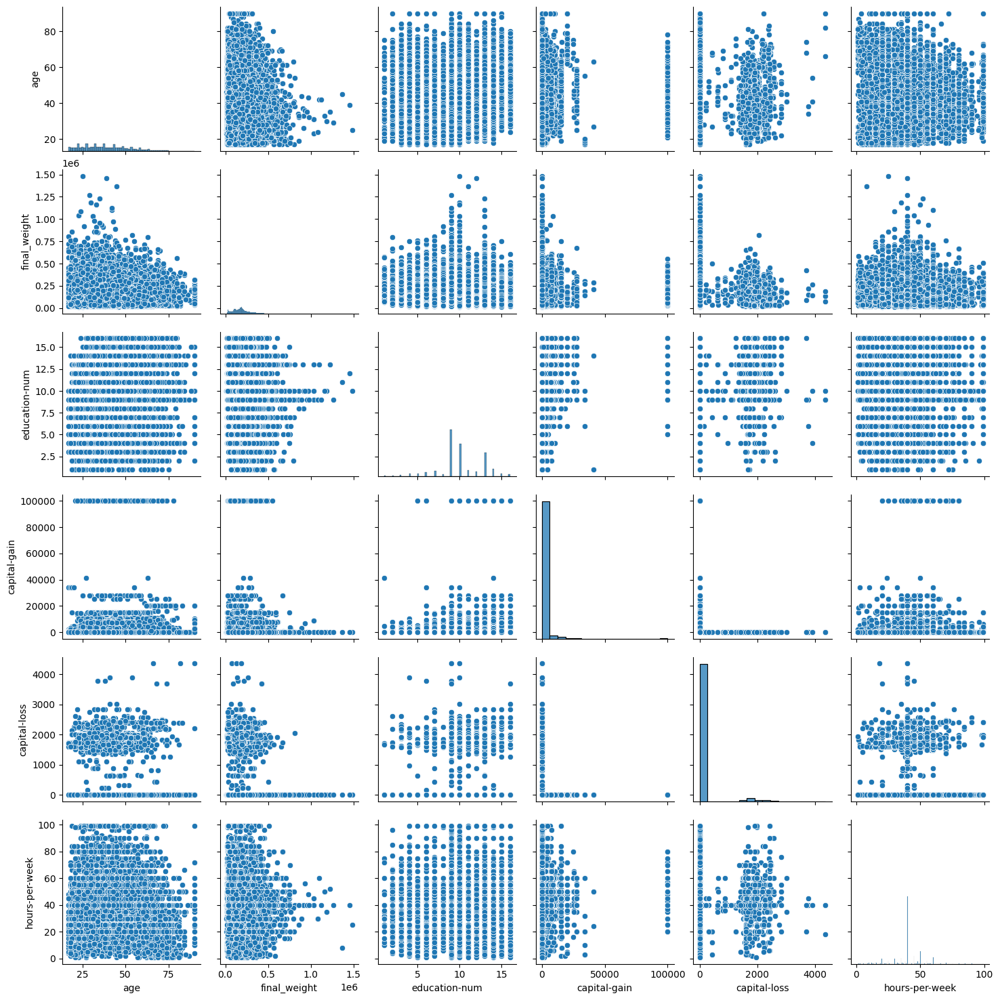

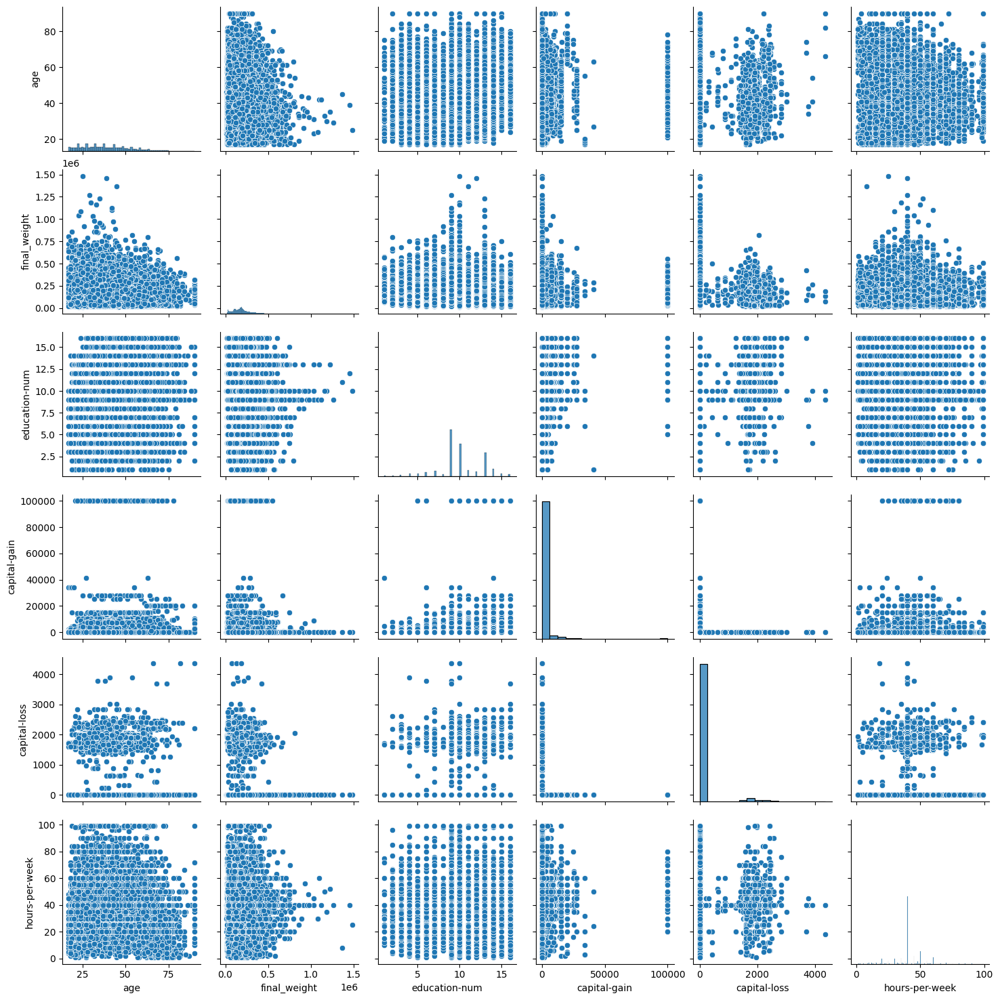

In [214]:
sns.pairplot(adult_data_develop_numerical_df[numerical_features])
sns.pairplot(adult_data_test_numerical_df[numerical_features])

In [215]:
scaler = StandardScaler()
adult_data_develop_numerical_df[numerical_features] = scaler.fit_transform(adult_data_develop_numerical_df[numerical_features].values)
adult_data_test_numerical_df[numerical_features] = scaler.transform(adult_data_test_numerical_df[numerical_features].values)

In [216]:
adult_data_develop_numerical_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,0.030671,7,-1.063611,9,1.134739,4,1,1,4,1,0.148453,-0.21666,-0.035429,39,0
1,0.837109,6,-1.008707,9,1.134739,2,4,0,4,1,-0.145920,-0.21666,-2.222153,39,0
2,-0.042642,4,0.245079,11,-0.420060,0,6,1,4,1,-0.145920,-0.21666,-0.035429,39,0
3,1.057047,4,0.425801,1,-1.197459,2,6,0,2,1,-0.145920,-0.21666,-0.035429,39,0
4,-0.775768,4,1.408176,9,1.134739,2,10,5,2,0,-0.145920,-0.21666,-0.035429,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,-0.849080,4,0.639741,7,0.746039,2,13,5,4,0,-0.145920,-0.21666,-0.197409,39,0
32557,0.103983,4,-0.335433,11,-0.420060,2,7,0,4,1,-0.145920,-0.21666,-0.035429,39,1
32558,1.423610,4,-0.358777,11,-0.420060,6,1,4,4,0,-0.145920,-0.21666,-0.035429,39,0
32559,-1.215643,4,0.110960,11,-0.420060,4,1,3,4,1,-0.145920,-0.21666,-1.655225,39,0


In [217]:
adult_data_test_numerical_df

,age,workclass,final_weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income_class
0,0.030671,7,-1.063611,9,1.134739,4,1,1,4,1,0.148453,-0.21666,-0.035429,39,0
1,0.837109,6,-1.008707,9,1.134739,2,4,0,4,1,-0.145920,-0.21666,-2.222153,39,0
2,-0.042642,4,0.245079,11,-0.420060,0,6,1,4,1,-0.145920,-0.21666,-0.035429,39,0
3,1.057047,4,0.425801,1,-1.197459,2,6,0,2,1,-0.145920,-0.21666,-0.035429,39,0
4,-0.775768,4,1.408176,9,1.134739,2,10,5,2,0,-0.145920,-0.21666,-0.035429,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,-0.849080,4,0.639741,7,0.746039,2,13,5,4,0,-0.145920,-0.21666,-0.197409,39,0
32557,0.103983,4,-0.335433,11,-0.420060,2,7,0,4,1,-0.145920,-0.21666,-0.035429,39,1
32558,1.423610,4,-0.358777,11,-0.420060,6,1,4,4,0,-0.145920,-0.21666,-0.035429,39,0
32559,-1.215643,4,0.110960,11,-0.420060,4,1,3,4,1,-0.145920,-0.21666,-1.655225,39,0


In [218]:
px.box(adult_data_develop_numerical_df[numerical_features]).show()
px.box(adult_data_test_numerical_df[numerical_features]).show()

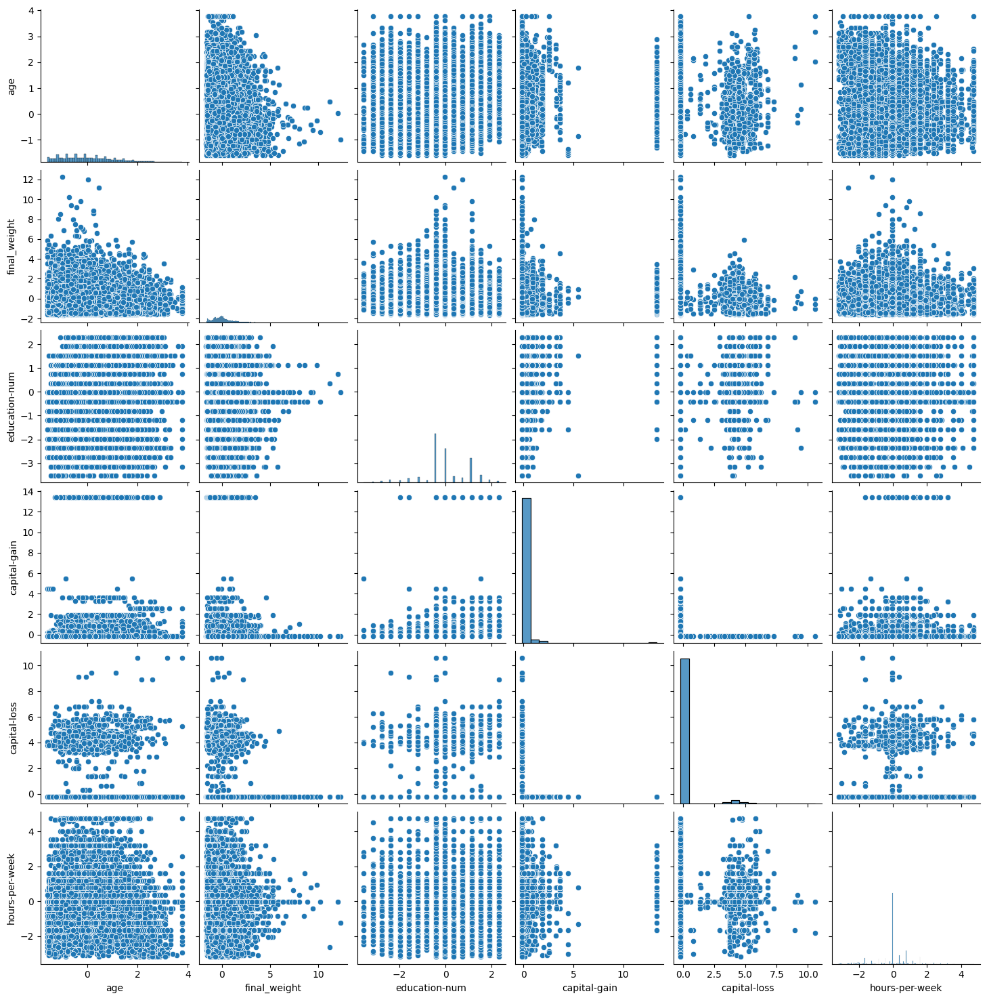

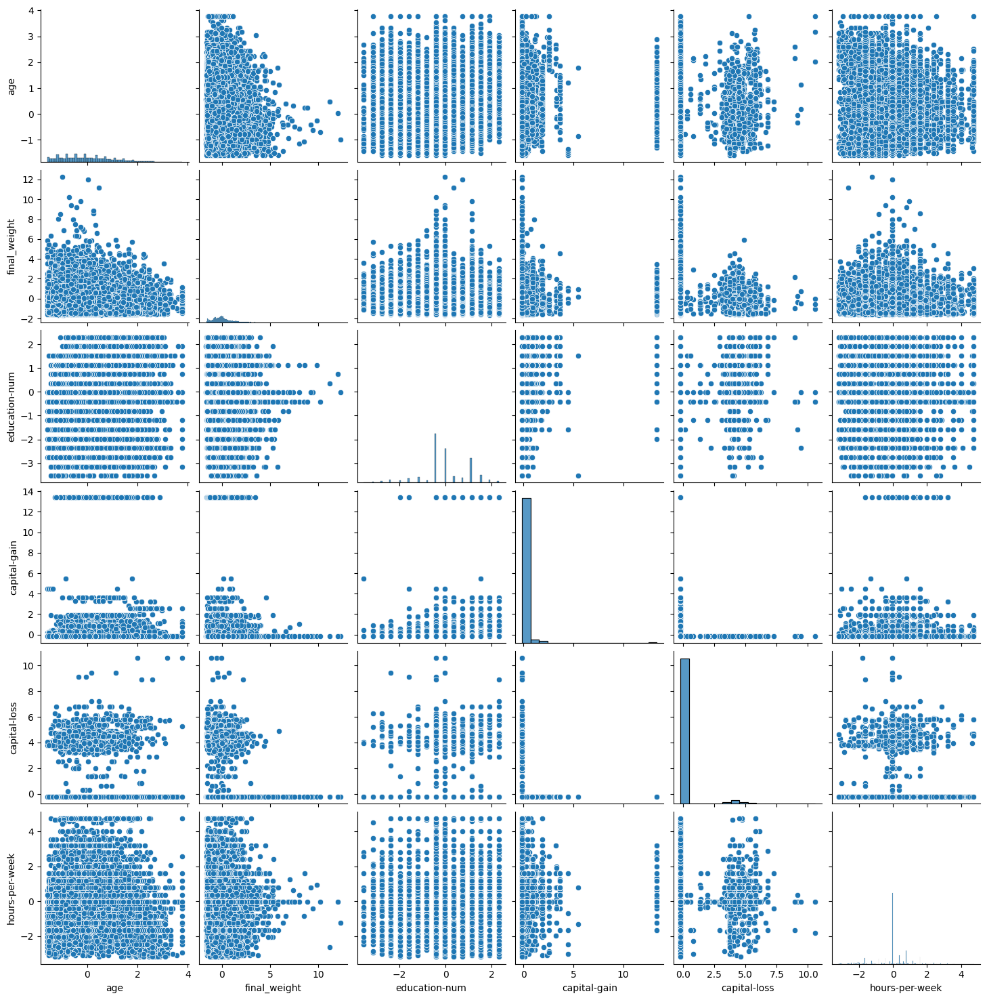

In [219]:
sns.pairplot(adult_data_develop_numerical_df[numerical_features])
sns.pairplot(adult_data_test_numerical_df[numerical_features])

# KNN

In [220]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split

In [221]:
K = np.arange(2, 10 + 1, 1)
K

array([ 2,  3,  4,  5,  6,  7,  8,  9, 10])

In [222]:
X_develop = adult_data_develop_numerical_df[feature_columns]
y_develop = adult_data_develop_numerical_df[label_columns]
X_test = adult_data_test_numerical_df[feature_columns]
y_test = adult_data_test_numerical_df[label_columns]

In [223]:
X_train, X_val, y_train, y_val = train_test_split(X_develop, y_develop, test_size=0.2, random_state=42)

In [224]:
scores: List[Tuple[int, float, float]] = []

for ki in K:
    model = KNeighborsClassifier(ki)
    model.fit(X_train, y_train)
    train_score = model.score(X_train, y_train)
    val_score = model.score(X_val, y_val)
    scores.append((ki, train_score, val_score))

scores_df = pd.DataFrame(scores, columns=["K", "Train Score", "Validation Score"])
scores_df.set_index("K", inplace=True)
scores_df

,Train Score,Validation Score
K,,
2,0.896038,0.817749
3,0.895002,0.819745
4,0.876190,0.824965
5,0.877111,0.824198
6,0.865556,0.826347
7,0.864942,0.829111
8,0.859068,0.830493
9,0.858838,0.833717
10,0.853924,0.831721


In [225]:
px.scatter(
    scores_df,
    x=scores_df.index,
    y=["Train Score", "Validation Score"],
    title="KNN - Train and Validation Scores",
    range_y=[0, 1],
    range_x=[K[0], K[-1]]
)

In [226]:
best_k = scores_df["Validation Score"].idxmax()
best_knn = KNeighborsClassifier(best_k)
best_knn.fit(X_develop, y_develop)
best_knn.score(X_test, y_test)

0.8612143361690365

# Logistic Regression Classifier

In [227]:
from sklearn.linear_model import LogisticRegression

In [228]:
solvers = {
    "newton-cg": ["l2"],
    "lbfgs": ["l2"],
    "liblinear": ["l1", "l2"],
    "sag": ["l2"],
    "saga": ["l1", "l2"]
}
scores: List[Tuple[str, str, float, float]] = []

for solver, penalties in solvers.items():
    for penalty in penalties:
        model = LogisticRegression(solver=solver, penalty=penalty)
        model.fit(X_train, y_train)
        train_score = model.score(X_train, y_train)
        val_score = model.score(X_val, y_val)
        scores.append((solver, penalty, train_score, val_score))
    
scores_df = pd.DataFrame(scores, columns=["Solver", "Penalty", "Train Score", "Validation Score"])
scores_df.set_index(["Solver", "Penalty"], inplace=True)
scores_df

/Users/owen/miniconda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Train Score  Validation Score
Solver    Penalty                               
newton-cg l2          0.824555          0.824812
lbfgs     l2          0.825246          0.824505
liblinear l1          0.824593          0.825119
          l2          0.824593          0.825119
sag       l2          0.824478          0.825119
saga      l1          0.824593          0.825119
          l2          0.824593          0.825119

In [229]:
best_solver, best_penalty = scores_df["Validation Score"].idxmax()
best_logistic_regression = LogisticRegression(solver=best_solver, penalty=best_penalty)
best_logistic_regression.fit(X_develop, y_develop)
best_logistic_regression.score(X_test, y_test)

0.8249439513528455